# Setup Enviroment

In [1]:
import warnings
warnings.filterwarnings("ignore")

In [2]:
import os
import gc
import numpy as np
import pandas as pd
import cv2 as cv
import matplotlib.pyplot as plt
from datetime import datetime

import keras.backend as K
import tensorflow as tf
from tensorflow.keras.layers import Conv2D, BatchNormalization, Input, Conv2DTranspose, Concatenate, Activation, Add
from tensorflow.keras import Model
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import ReduceLROnPlateau, EarlyStopping

D1121 05:49:40.205894613      15 config.cc:119]                        gRPC EXPERIMENT tcp_frame_size_tuning               OFF (default:OFF)
D1121 05:49:40.205920248      15 config.cc:119]                        gRPC EXPERIMENT tcp_rcv_lowat                       OFF (default:OFF)
D1121 05:49:40.205923790      15 config.cc:119]                        gRPC EXPERIMENT peer_state_based_framing            OFF (default:OFF)
D1121 05:49:40.205926363      15 config.cc:119]                        gRPC EXPERIMENT flow_control_fixes                  ON  (default:ON)
D1121 05:49:40.205928821      15 config.cc:119]                        gRPC EXPERIMENT memory_pressure_controller          OFF (default:OFF)
D1121 05:49:40.205931444      15 config.cc:119]                        gRPC EXPERIMENT unconstrained_max_quota_buffer_size OFF (default:OFF)
D1121 05:49:40.205933791      15 config.cc:119]                        gRPC EXPERIMENT new_hpack_huffman_decoder           ON  (default:ON)
D1121 05:49:40.

In [3]:
def set_seed(seed=99):
    np.random.seed(seed)
    tf.random.set_seed(seed)
    os.environ['PYTHONHASHSEED'] = str(seed)
    os.environ['TF_DETERMINISTIC_OPS'] = '1'
set_seed()

tpu = tf.distribute.cluster_resolver.TPUClusterResolver.connect()
strategy = tf.distribute.TPUStrategy(tpu)

INFO:tensorflow:Deallocate tpu buffers before initializing tpu system.
INFO:tensorflow:Initializing the TPU system: local
INFO:tensorflow:Finished initializing TPU system.
INFO:tensorflow:Found TPU system:
INFO:tensorflow:*** Num TPU Cores: 8
INFO:tensorflow:*** Num TPU Workers: 1
INFO:tensorflow:*** Num TPU Cores Per Worker: 8
INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:localhost/replica:0/task:0/device:CPU:0, CPU, 0, 0)
INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:localhost/replica:0/task:0/device:TPU:0, TPU, 0, 0)
INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:localhost/replica:0/task:0/device:TPU:1, TPU, 0, 0)
INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:localhost/replica:0/task:0/device:TPU:2, TPU, 0, 0)
INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:localhost/replica:0/task:0/device:TPU:3, TPU, 0, 0)
INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:localhost/replica:0/task:0/device:TPU:4, TPU

# Pre-Processing

In [4]:
corupt_images = [
    "27178705_15",
    "99238660_15",
    "99238675_15",
    "27028675_15",
    "26878750_15",
    "26728765_15",
    "26728780_15",
    "26878675_15",
    "26728675_15",
    "26578795_15",
    "26429275_15",
    "26578675_15",
    "26578690_15",
    "26428795_15",
    "26428690_15",
    "26428705_15",
    "26278810_15",
    "26129290_15",
    "26278705_15",
    "26128810_15",
    "26128795_15",
    "26128735_15",
    "25979290_15",
    "26128705_15",
    "26128720_15",
    "25979230_15",
    "25229185_15",
    "25679275_15",
    "25828765_15",
    "25978765_15",
    "25828780_15",
    "25978780_15",
    "25529290_15",
    "25978795_15",
    "25379185_15",
    "25829290_15",
    "24779305_15",
    "25978735_15",
    "25978750_15",
    "25829275_15",
    "24928900_15",
    "25079155_15",
    "25379290_15",
    "25529170_15",
    "25229155_15",
    "25229170_15",
    "24778825_15",
    "24778840_15",
    "24629305_15",
    "24778780_15",
    "24479290_15",
    "24778900_15",
    "24778915_15",
    "24779155_15",
    "24778855_15",
    "24778870_15",
    "24778885_15",
    "24778810_15",
    "24629155_15",
    "24628795_15",
    "24479095_15",
    "24479110_15",
    "24479155_15",
    "24478900_15",
    "24478990_15",
    "24478765_15",
    "24329110_15",
    "24329155_15",
    "24329170_15",
    "24328795_15",
    "24328765_15",
    "24328780_15",
    "24179170_15",
    "24179185_15",
    "24029185_15",
    "24028825_15",
    "24028555_15",
    "24329050_15",
    "24329095_15",
    "24328885_15",
    "24329005_15",
    "24328870_15",
    "24179260_15",
    "24179275_15",
    "24179110_15",
    "24178975_15",
    "24179005_15",
    "24178540_15",
    "24178480_15",
    "24029200_15",
    "24029110_15",
    "24028795_15",
    "24028480_15",
    "23879230_15",
    "23879200_15",
    "23879215_15",
    "23878975_15",
    "23878930_15",
    "23878945_15",
    "23878960_15",
    "23878570_15",
    "23878585_15",
    "23878480_15",
    "23728600_15",
    "23728765_15",
    "23878915_15",
    "23878765_15",
    "23729110_15",
    "23729230_15",
    "23729245_15",
    "23728840_15",
    "23728915_15",
    "23579140_15",
    "23579155_15",
    "23728480_15",
    "23728495_15",
    "23579110_15",
    "23579125_15",
    "23429170_15",
    "23578495_15",
    "23578510_15",
    "23429035_15",
    "23429050_15",
    "23429065_15",
    "23428525_15",
    "23428570_15",
    "23578915_15",
    "23578780_15",
    "23578795_15",
    "23428900_15",
    "23428915_15",
    "23428585_15",
    "23279170_15",
    "23428510_15",
    "23279035_15",
    "23279050_15",
    "23279080_15",
    "23279095_15",
    "23279020_15",
    "23278840_15",
    "23129410_15",
    "23129425_15",
    "23129440_15",
    "22979455_15",
    "22979470_15",
    "22979065_15",
    "22978855_15",
    "23278885_15",
    "23129455_15",
    "23129140_15",
    "23129155_15",
    "23129170_15",
    "23129050_15",
    "23129065_15",
    "23129110_15",
    "23129125_15",
    "23128870_15",
    "22829470_15",
    "22829485_15",
    "22978840_15",
    "22829065_15",
    "22679485_15",
    "22529440_15",
    "22529455_15",
    "22529470_15",
    "22529485_15",
    "22679065_15",
    "22679080_15",
    "22529395_15",
    "22529080_15",
    "22529380_15",
    "22379440_15",
    "22379065_15",
    "22379080_15",
    "22379380_15",
    "22229440_15",
    "22079080_15",
    "21929080_15",
    "22229380_15",
    "22229065_15",
    "22229080_15",
    "22229365_15",
    "21928960_15",
    "21928945_15",
    "21779065_15",
    "21779080_15",
    "21778930_15",
    "21629065_15",
    "21628930_15",
    "21479050_15",
    "21479065_15",
    "21628870_15",
    "21628885_15",
    "21478930_15",
    "21329035_15",
    "21329050_15",
    "21478870_15",
    "21178975_15",
    "21778945_15",
    "21778960_15",
    "21628945_15",
    "21628960_15",
    "21478945_15",
    "21328975_15",
    "21328990_15",
    "21329005_15",
    "21329020_15",
    "21328870_15",
    "21028975_15",
    "21178885_15",
    "20879005_15",
    "21028900_15",
    "20729005_15",
    "20579005_15",
    "20279005_15",
    "20878990_15",
    "20878900_15",
    "20729970_15",
    "20728885_15",
    "20429005_15",
    "20578870_15",
    "20428870_15",
    "20129005_15",
    "19978945_15",
    "19978885_15",
    "19978630_15",
    "19828885_15",
    "19828630_15",
    "19528675_15",
    "19078765_15",
    "19228735_15",
    "19228750_15",
    "19528630_15",
    "18928780_15",
    "18928795_15",
    "18778795_15",
    "18928720_15",
    "18778720_15",
    "18478975_15",
    "18628720_15",
    "18478885_15",
    "19978645_15",
    "19978660_15",
    "19978675_15",
    "19828915_15",
    "19678630_15",
    "19528645_15",
    "19528660_15",
    "19078735_15",
    "19078750_15",
    "18928765_15",
    "18628795_15",
    "18628885_15",
    "18628900_15",
    "18628915_15",
    "18628930_15",
    "18478945_15",
    "18478960_15",
    "18478795_15",
    "18328975_15",
    "18478720_15",
    "18178975_15",
    "18328720_15",
    "18028960_15",
    "18178705_15",
    "18028810_15",
    "17878810_15",
    "17878855_15",
    "17878870_15",
    "17728960_15",
    "18328810_15",
    "18328885_15",
    "18178810_15",
    "18178825_15",
    "18178885_15",
    "18028825_15",
    "18028870_15",
    "17878960_15",
    "18028705_15",
    "17728975_15",
    "17728990_15",
    "17878705_15",
    "17728795_15",
    "17728810_15",
    "17728855_15",
    "17728705_15",
    "17728720_15",
    "17578975_15",
    "17578855_15",
    "17428975_15",
    "17578720_15",
    "17428780_15",
    "17428855_15",
    "17428870_15",
    "17278960_15",
    "17428735_15",
    "17128960_15",
    "17278750_15",
    "17278765_15",
    "17278780_15",
    "17278870_15",
    "17578990_15",
    "17578795_15",
    "17578840_15",
    "17428750_15",
    "17128945_15",
    "16978945_15",
    "17128870_15",
    "17128885_15",
    "16978930_15",
    "16828900_15",
    "16828915_15",
    "16378840_15",
    "16378855_15",
    "16228900_15",
    "16228915_15",
    "16228930_15",
    "15928960_15",
    "15928960_15",
    "16078825_15",
    "15778960_15",
    "15628960_15",
    "15628885_15",
    "15628900_15",
    "16828930_15",
    "16978870_15",
    "16978885_15",
    "16228945_15",
    "16228960_15",
    "16378825_15",
    "16228870_15",
    "16228885_15",
    "16078960_15",
    "16228825_15",
    "15628915_15",
    "15628930_15",
    "12628810_15",
    "15628825_15",
    "15628840_15",
    "15628855_15",
    "15628870_15",
    "12628765_15",
    "12628780_15",
    "12628795_15",
    "12478810_15",
    "12328720_15",
    "12178705_15",
    "12028660_15",
    "12028675_15",
    "12028690_15",
    "12478780_15",
    "12478795_15",
    "12478720_15",
    "12028705_15",
    "11878795_15",
    "11428660_15",
    "11278900_15",
    "11278915_15",
    "11278930_15",
    "11278870_15",
    "11428930_15",
    "11428945_15",
    "11278885_15",
    "11278645_15",
    "10978930_15",
    "10978945_15",
    "11128645_15",
    "10828825_15",
    "10828855_15",
    "10828870_15",
    "10828900_15",
    "10828645_15",
    "10678795_15",
    "10678810_15",
    "10678825_15",
    "10678870_15",
    "10528795_15",
    "10978915_15",
    "10978840_15",
    "10978855_15",
    "10978645_15",
    "10678885_15",
    "10528795_15",
    "10378795_15",
    "10228765_15",
    "10228780_15",
    "10228795_15",
    "10078750_15",
    "10078660_15",
    "10078690_15",
    "10378660_15",
    "10228660_15",
    "10078705_15",
    "10078705_15",
    "10078720_15",
    "10078735_15", 
]

In [5]:
cwd = '/kaggle/input/massachusetts-roads-dataset/'
metadata = pd.read_csv(os.path.join(cwd, 'metadata.csv'))

train_images, train_labels, val_images, val_labels, test_images, test_labels = list(), list(), list(), list(), list(), list()

for row in metadata.index:
    img_data = metadata.iloc[row]
    
    if img_data.image_id in corupt_images:
        continue

    img = cv.imread(os.path.join(cwd, img_data.tiff_image_path))
    img = (img).astype(np.uint8)

    img_label = cv.imread(os.path.join(cwd, img_data.tif_label_path))
    img_label = img_label[:, :, 1]
    img_label = (img_label / 255.0).astype(np.uint8)

    for y in range(256 + 0, img.shape[0] + 255, 256):
        for x in range(256 + 0, img.shape[1] + 255, 256):
            if y > img.shape[0]:
                y = img.shape[0]

            if x > img.shape[1]:
                x = img.shape[1]

            crop_img = img[y-256:y, x-256:x]
            crop_img_label = img_label[y-256:y, x-256:x]

            if metadata.iloc[row].split == "train":
                train_images.append(crop_img)
                train_labels.append(crop_img_label)
            
            elif metadata.iloc[row].split == "val":
                val_images.append(crop_img)
                val_labels.append(crop_img_label)
                
            elif metadata.iloc[row].split == "test":
                test_images.append(crop_img)
                test_labels.append(crop_img_label)
                
#     for y in range(256 + 128, img.shape[0], 256):
#         for x in range(256 + 128, img.shape[1], 256):
#             if y > img.shape[0]:
#                 y = img.shape[0]

#             if x > img.shape[1]:
#                 x = img.shape[1]

#             crop_img = img[y-256:y, x-256:x]
#             crop_img_label = img_label[y-256:y, x-256:x]

#             if metadata.iloc[row].split == "train":
#                 train_images.append(crop_img)
#                 train_labels.append(crop_img_label)
                
#             elif metadata.iloc[row].split == "val":
#                 val_images.append(crop_img)
#                 val_labels.append(crop_img_label)
                
#             elif metadata.iloc[row].split == "test":
#                 test_images.append(crop_img)
#                 test_labels.append(crop_img_label)

gc.collect()

for i in range(len(train_images)):
    train_images.append(cv.flip(train_images[i], -1))
    train_labels.append(cv.flip(train_labels[i], -1))
    
gc.collect()

train_images = np.reshape(train_images, (len(train_images), 256, 256, 3))
train_labels = np.reshape(train_labels, (len(train_labels), 256, 256, 1))

val_images = np.reshape(val_images, (len(val_images), 256, 256, 3))
val_labels = np.reshape(val_labels, (len(val_labels), 256, 256, 1))

test_images = np.reshape(test_images, (len(test_images), 256, 256, 3))
test_labels = np.reshape(test_labels, (len(test_labels), 256, 256, 1))

gc.collect()

print(train_images.shape)
print(train_labels.shape)
print(val_images.shape)
print(val_labels.shape)
print(test_images.shape)
print(test_labels.shape)

(51552, 256, 256, 3)
(51552, 256, 256, 1)
(504, 256, 256, 3)
(504, 256, 256, 1)
(1764, 256, 256, 3)
(1764, 256, 256, 1)


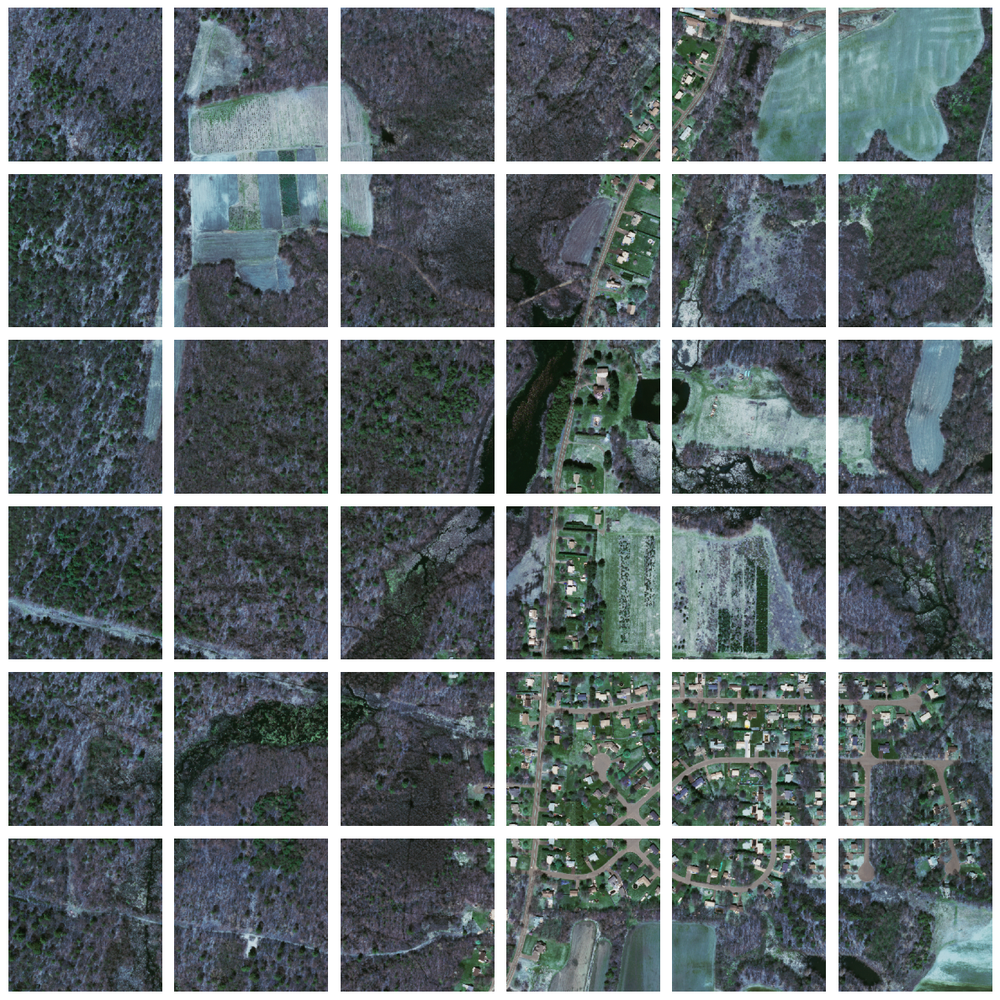

In [6]:
fig, axes = plt.subplots(6, 6, figsize=(12, 12))
axes = axes.ravel()

for i in range(36):
    axes[i].imshow(train_images[i])
    axes[i].axis('off')

plt.tight_layout()
plt.show()

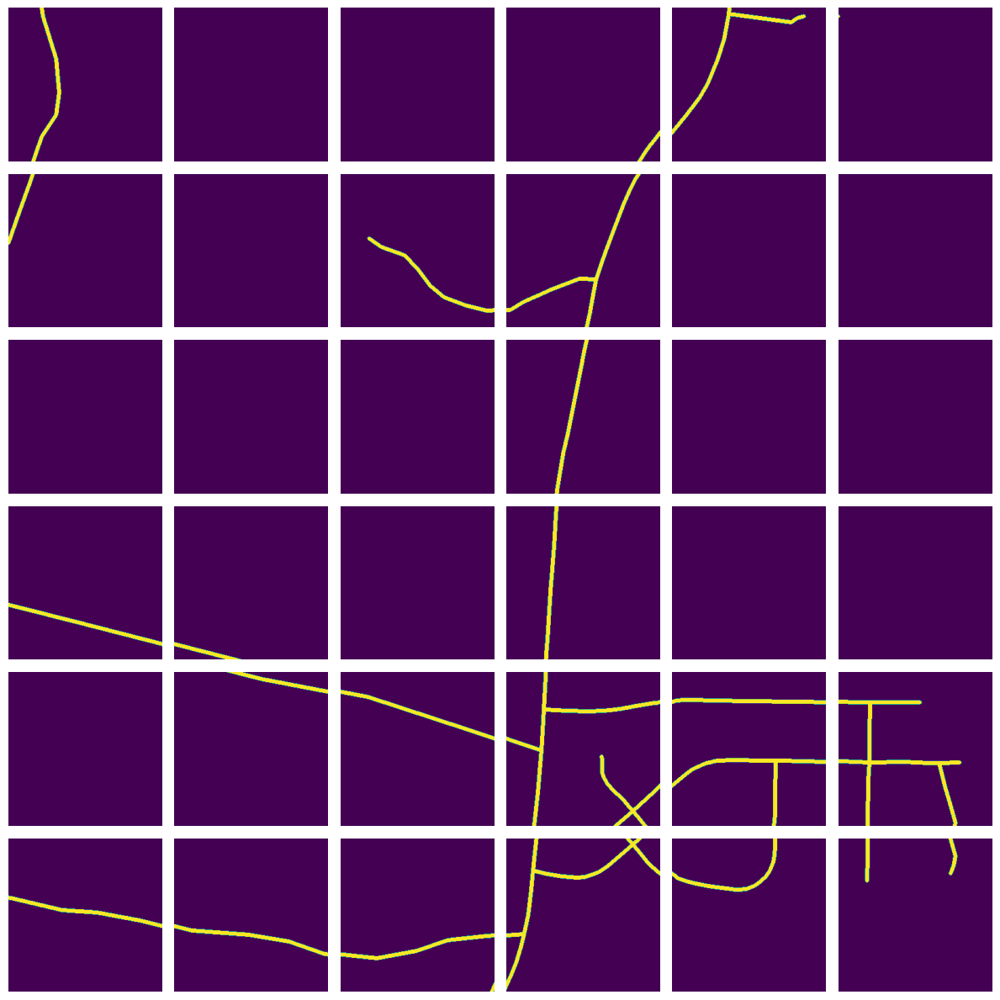

In [7]:
fig, axes = plt.subplots(6, 6, figsize=(12, 12))
axes = axes.ravel()

for i in range(36):
    axes[i].imshow(train_labels[i])
    axes[i].axis('off')

plt.tight_layout()
plt.show()

In [8]:
def plot_loss(data, legend, title):
    fig = plt.figure(figsize=(10, 11))
    spec = fig.add_gridspec(ncols=2, nrows=2)
    spec.update(hspace=0.25)

    ax0 = fig.add_subplot(spec[0, :])
    for x in data:
        ax0.plot(x)

    ax0.set_xticks(list(range(0, 31, 5)))
    ax0.set_xticklabels(list(range(1, 32, 5)))
    ax0.set_title(title)
    ax0.legend(legend)
    plt.setp(ax0, xlabel='Epoch', ylabel='Loss')

    ax1 = fig.add_subplot(spec[1, :])
    for x in data:
        ax1.plot(x[-5:])

    ax1.set_xticks(list(range(5)))
    ax1.set_xticklabels(list(range(26, 31)))
    ax1.set_title(title)
    ax1.legend(legend, loc='upper left')
    plt.setp(ax1, xlabel='Epoch', ylabel='Loss')

In [9]:
class DiceLoss(tf.keras.losses.Loss):
    def __init__(self, smooth=1e-15, name='dice_loss'):
        super(DiceLoss, self).__init__(name=name)
        self.smooth = smooth

    def dsc(self, y_true, y_pred):
        y_true_f = tf.cast(y_true, tf.float32)
        y_true_f = K.flatten(y_true_f)
        y_pred_f = K.flatten(y_pred)
        intersection = K.sum(y_true_f * y_pred_f)
        score = (2. * intersection + self.smooth) / (K.sum(y_true_f) + K.sum(y_pred_f) + self.smooth)
        return score

    def call(self, y_true, y_pred):
        loss = 1 - self.dsc(y_true, y_pred)
        return loss

tf.keras.utils.get_custom_objects().update({'dice': DiceLoss()})

def f1(y_true, y_pred):
    y_pred = tf.round(y_pred)
    return 2 * tf.reduce_sum(y_true * y_pred) / (tf.reduce_sum(y_true) + tf.reduce_sum(y_pred) + 1e-15)

# Define Network

In [10]:
# conv bn act, conv bn act, conv bn, add
class StartResBlock(tf.keras.Model):
    def __init__(self, filters, ratio, activation, name, strides):
        super(StartResBlock, self).__init__()

        self.filters = filters
        self.ratio = int(filters*ratio)
        self.activation = activation
        self.strides = strides
        self.names = name

        self.startconv = Conv2D(filters=self.filters, kernel_size=1,
                                padding='same', strides=self.strides, name=self.names+'startconv')

        self.pointwise_start = Conv2D(filters=self.ratio, kernel_size=1,
                                      padding='same', strides=1, name=self.names+'pointwise-start')
        self.depthwise = Conv2D(filters=self.ratio, kernel_size=3, padding='same',
                                strides=1, groups=self.ratio, name=self.names+'depthwise')
        self.pointwise_end = Conv2D(filters=self.filters, kernel_size=1,
                                    padding='same', strides=1, name=self.names+'pointwise-end')

        self.bn1 = BatchNormalization(name=self.names+'bn1')
        self.bn2 = BatchNormalization(name=self.names+'bn2')
        self.bn3 = BatchNormalization(name=self.names+'bn3')

        self.activation1 = Activation(
            activation, name=self.names+'activation1')
        self.activation2 = Activation(
            activation, name=self.names+'activation2')

    def call(self, t):

        t = self.startconv(t)

        skip = t

        t = self.pointwise_start(t)
        t = self.bn1(t)
        t = self.activation1(t)

        t = self.depthwise(t)
        t = self.bn2(t)
        t = self.activation2(t)

        t = self.pointwise_end(t)
        t = self.bn3(t)

        t = Add()([skip, t])

        return t

In [11]:
# *bn act conv, bn act conv, bn act conv, add
class MiddleResBlock(tf.keras.Model):
    def __init__(self, filters, ratio, activation, name):
        super(MiddleResBlock, self).__init__()

        self.filters = filters
        self.ratio = int(filters*ratio)
        self.activation = activation
        self.names = name

        self.pointwise_start = Conv2D(filters=self.ratio, kernel_size=1,
                                      padding='same', strides=1, name=self.names+'pointwise-start')
        self.depthwise = Conv2D(filters=self.ratio, kernel_size=3, padding='same',
                                strides=1, groups=self.ratio, name=self.names+'depthwise')
        self.pointwise_end = Conv2D(filters=self.filters, kernel_size=1,
                                    padding='same', strides=1, name=self.names+'pointwise-end')

        self.bn1 = BatchNormalization(name=self.names+'bn1')
        self.bn2 = BatchNormalization(name=self.names+'bn2')

        self.activation1 = Activation(
            activation, name=self.names+'activation1')
        self.activation2 = Activation(
            activation, name=self.names+'activation2')
        self.activation3 = Activation(
            activation, name=self.names+'activation3')

    def call(self, t):
        skip = t

        t = self.activation1(t)
        t = self.pointwise_start(t)

        t = self.bn1(t)
        t = self.activation2(t)
        t = self.depthwise(t)

        t = self.bn2(t)
        t = self.activation3(t)
        t = self.pointwise_end(t)

        t = Add()([skip, t])

        return t

In [12]:
# bn act conv, bn act conv, bn act conv, add, bn act
class EndResBlock(tf.keras.Model):
    def __init__(self, filters, ratio, activation, name, transpose=False):
        super(EndResBlock, self).__init__()

        self.filters = filters
        self.ratio = int(filters*ratio)
        self.activation = activation
        self.transpose = transpose
        self.names = name

        self.pointwise_start = Conv2D(filters=self.ratio, kernel_size=1,
                                      padding='same',  strides=1, name=self.names+'pointwise-start')
        self.depthwise = Conv2D(filters=self.ratio, kernel_size=3, strides=1,
                                padding='same', groups=self.ratio, name=self.names+'depthwise')
        self.pointwise_end = Conv2D(filters=self.filters, kernel_size=1,
                                    padding='same', strides=1, name=self.names+'pointwise-end')

        self.convtranspose = Conv2DTranspose(
            filters=self.filters//2, kernel_size=1, padding='same', strides=2, name=self.names+'depthwise_transpose')

        self.bn1 = BatchNormalization(name=self.names+'bn1')
        self.bn2 = BatchNormalization(name=self.names+'bn2')
        self.bn3 = BatchNormalization(name=self.names+'bn3')
        self.bn4 = BatchNormalization(name=self.names+'bn4')

        self.activation1 = Activation(
            activation, name=self.names+'activation1')
        self.activation2 = Activation(
            activation, name=self.names+'activation2')
        self.activation3 = Activation(
            activation, name=self.names+'activation3')
        self.activation4 = Activation(
            activation, name=self.names+'activation4')

    def call(self, t):
        skip = t

        t = self.bn1(t)
        t = self.activation1(t)
        t = self.pointwise_start(t)

        t = self.bn2(t)
        t = self.activation2(t)
        t = self.depthwise(t)

        t = self.bn3(t)
        t = self.activation3(t)
        t = self.pointwise_end(t)

        t = Add()([skip, t])
        t = self.bn4(t)
        t = self.activation4(t)

        if self.transpose:
            t = self.convtranspose(t)

        return t

In [13]:
class ResGroup(tf.keras.Model):
    def __init__(self, filters, ratio, activation, name, strides, transpose):
        super(ResGroup, self).__init__()
        
        self.filters = filters
        self.ratio = ratio
        self.activation = activation
        self.strides = strides
        self.transpose = transpose
        self.names = name
        
        self.start = StartResBlock(filters=self.filters, ratio=self.ratio, activation=self.activation, strides=self.strides, name=self.names+'start')
        self.middle = MiddleResBlock(filters=self.filters, ratio=self.ratio, activation=self.activation, name=self.names+'middle')
        self.end = EndResBlock(filters=self.filters, ratio=self.ratio, activation=self.activation, transpose=self.transpose, name=self.names+'end')
        
    def call(self, t):
        t = self.start(t)
        t = self.middle(t)
        t = self.end(t)
        
        return t

In [14]:
def create_model(filters, ratio, activation, loss):
    with strategy.scope():
        input_layer = Input(shape=(256, 256, 3))

        e1 = ResGroup(filters=filters, ratio=ratio, activation=activation, strides=1, transpose=False, name='encoder1')(input_layer) # 256, 256, 64

        e2 = ResGroup(filters=filters*2, ratio=ratio, activation=activation, strides=2, transpose=False, name='encoder2')(e1) # 128, 128, 128
        
        e3 = ResGroup(filters=filters*4, ratio=ratio, activation=activation, strides=2, transpose=False, name='encoder3')(e2) # 64, 64, 256
        
        e4 = ResGroup(filters=filters*8, ratio=ratio, activation=activation, strides=2, transpose=False, name='encoder4')(e3) # 32, 32, 512

        b = ResGroup(filters=filters*16, ratio=ratio, activation=activation, strides=2, transpose=True, name='bridge')(e4) # 16, 16, 1024
        
        d1 = Concatenate()([b, e4]) 
        d1 = ResGroup(filters=filters*8, ratio=ratio, activation=activation, strides=1, transpose=True, name='decoder1')(d1) # 32, 32, 512

        d2 = Concatenate()([d1, e3]) 
        d2 = ResGroup(filters=filters*4, ratio=ratio, activation=activation, strides=1, transpose=True, name='decoder2')(d2) # 64, 64, 256

        d3 = Concatenate()([d2, e2])
        d3 = ResGroup(filters=filters*2, ratio=ratio, activation=activation, strides=1, transpose=True, name='decoder3')(d3) # 128, 128, 128
        
        d4 = Concatenate()([d3, e1])
        d4 = ResGroup(filters=filters, ratio=ratio, activation=activation, strides=1, transpose=False, name='deocoder4')(d4) # 256, 256, 64

        output_layer = Conv2D(filters=1, kernel_size=1, padding='same', activation='sigmoid')(d4)

        model = Model(inputs=input_layer, outputs=output_layer)
        model.compile(optimizer='Adam', loss=loss, metrics=[f1])

        return model
    
model = create_model(filters=64, ratio=1, activation='gelu', loss='dice')
model.summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 256, 256, 3  0           []                               
                                )]                                                                
                                                                                                  
 res_group (ResGroup)           (None, 256, 256, 64  29440       ['input_1[0][0]']                
                                )                                                                 
                                                                                                  
 res_group_1 (ResGroup)         (None, 128, 128, 12  115840      ['res_group[0][0]']              
                                8)                                                            

In [15]:
def train_model(model, name):
    early_stop = EarlyStopping(monitor='val_loss', patience=5, mode='auto', restore_best_weights=True)
    reduce_lr = ReduceLROnPlateau(monitor="val_loss", factor=0.1, patience=3, verbose=1)
    
    history = model.fit(
        train_images, train_labels,
        epochs=48,
        batch_size=64, 
        shuffle=True,
        verbose=1,
        validation_data=[val_images, val_labels],
        callbacks=[reduce_lr, early_stop]
    )

    model.save_weights(filepath=f'./weight_{name}.h5')
    np.save(f'history_{name}.npy',history.history)

# Tuning Hyperparameter

In [16]:
# start_time = datetime.now()

# for activation in ['relu', 'leaky_relu', 'selu', 'gelu']:
#     name = f'percobaan_activation: {activation}'
#     print(name)
#     model = create_model(filters=64, ratio=0.25, activation=activation, loss='dice')
#     train_model(model, name)

# end_time = datetime.now()
# training_duration = end_time - start_time
# print(f"Training duration: {training_duration}")

In [17]:
# loss = []
# plot_legend = []
# for activation in ['relu', 'leaky_relu', 'selu', 'gelu']:
#     plot_legend.append(f"activation = {activation}")
#     name = f'/kaggle/working/history_percobaan_activation: {activation}.npy'
#     history = np.load(name, allow_pickle=True).item()
#     loss.append(history["val_loss"])

# plot_loss(loss, plot_legend, "activation")

In [18]:
# start_time = datetime.now()

# for ratio in [0.25, 0.5, 1, 2]:
#     name = f'percobaan_ratio: {ratio}'
#     print(name)
#     model = create_model(filters=64, ratio=ratio, activation='relu', loss='dice')
#     train_model(model, name)

# end_time = datetime.now()
# training_duration = end_time - start_time
# print(f"Training duration: {training_duration}")

In [19]:
# loss = []
# plot_legend = []
# for ratio in [0.25, 0.5, 1, 2]:
#     plot_legend.append(f"ratio = {ratio}")
#     name = f'/kaggle/working/history_percobaan_ratio: {ratio}.npy'
#     history = np.load(name, allow_pickle=True).item()
#     loss.append(history["val_loss"])

# plot_loss(loss, plot_legend, "ratio")

In [20]:
# start_time = datetime.now()

# for loss in ['mae', 'mse', 'dice', 'bce']:
#     name = f'percobaan_loss: {loss}'
#     print(name)
#     model = create_model(filters=64, ratio=1, activation='gelu', loss=loss)
#     train_model(model, name)

# end_time = datetime.now()
# training_duration = end_time - start_time
# print(f"Training duration: {training_duration}")

In [21]:
# f1_score = []
# plot_legend = []
# for f1_score in ['mae', 'mse', 'dice', 'bce']:
#     plot_legend.append(f"f1_score = {f1_score}")
#     name = f'/kaggle/working/history_percobaan_loss: {loss}.npy'
#     history = np.load(name, allow_pickle=True).item()
#     loss.append(history["val_f1"])

# plot_loss(f1_score, plot_legend, "loss_function")

# Best Hyperparameter

In [22]:
start_time = datetime.now()

model = create_model(filters=64, ratio=1, activation='gelu', loss='dice')
train_model(model, 'ty')

end_time = datetime.now()
training_duration = end_time - start_time
print(f"Training duration: {training_duration}")

Epoch 1/48


2023-11-21 05:53:51.670541: E tensorflow/core/grappler/optimizers/meta_optimizer.cc:954] model_pruner failed: INVALID_ARGUMENT: Graph does not contain terminal node AssignAddVariableOp.
2023-11-21 05:53:53.440297: E tensorflow/core/grappler/optimizers/meta_optimizer.cc:954] model_pruner failed: INVALID_ARGUMENT: Graph does not contain terminal node AssignAddVariableOp.


806/806 [==============================] - ETA: 0s - loss: 0.3229 - f1: 0.6877

2023-11-21 06:00:40.347372: E tensorflow/core/grappler/optimizers/meta_optimizer.cc:954] model_pruner failed: INVALID_ARGUMENT: Graph does not contain terminal node AssignAddVariableOp.
2023-11-21 06:00:40.680924: E tensorflow/core/grappler/optimizers/meta_optimizer.cc:954] model_pruner failed: INVALID_ARGUMENT: Graph does not contain terminal node AssignAddVariableOp.


806/806 [==============================] - 492s 485ms/step - loss: 0.3229 - f1: 0.6877 - val_loss: 0.2666 - val_f1: 0.7342 - lr: 0.0010
Epoch 2/48
806/806 [==============================] - 285s 353ms/step - loss: 0.2587 - f1: 0.7416 - val_loss: 0.2663 - val_f1: 0.7341 - lr: 0.0010
Epoch 3/48
806/806 [==============================] - 285s 354ms/step - loss: 0.2489 - f1: 0.7512 - val_loss: 0.2611 - val_f1: 0.7393 - lr: 0.0010
Epoch 4/48
806/806 [==============================] - 285s 354ms/step - loss: 0.2429 - f1: 0.7572 - val_loss: 0.2509 - val_f1: 0.7493 - lr: 0.0010
Epoch 5/48
806/806 [==============================] - 284s 352ms/step - loss: 0.2394 - f1: 0.7606 - val_loss: 0.2914 - val_f1: 0.7088 - lr: 0.0010
Epoch 6/48
806/806 [==============================] - 284s 352ms/step - loss: 0.2360 - f1: 0.7640 - val_loss: 0.2521 - val_f1: 0.7482 - lr: 0.0010
Epoch 7/48
806/806 [==============================] - ETA: 0s - loss: 0.2328 - f1: 0.7672
Epoch 7: ReduceLROnPlateau reducing lea

# Evaluate

In [23]:
uji_x = test_images
uji_y = test_labels

def pengubinan(daftar_citra, bentuk=(1500, 1500, 1)):
    jumlah = np.zeros(bentuk, np.single)
    banyak = np.zeros(bentuk, np.single)
    indeks = 0

    for pos_y in range(256 + 0, bentuk[0] + 255, 256):
        for pos_x in range(256 + 0, bentuk[1] + 255, 256):
            if pos_y > bentuk[0]:
                pos_y = bentuk[0]
            if pos_x > bentuk[1]:
                pos_x = bentuk[1]
            jumlah[pos_y-256:pos_y, pos_x-256:pos_x] += daftar_citra[indeks]
            banyak[pos_y-256:pos_y, pos_x-256:pos_x] += 1
            indeks += 1

#     for pos_y in range(256 + 128, bentuk[0], 256):
#         for pos_x in range(256 + 128, bentuk[1], 256):
#             if pos_y > bentuk[0]:
#                 pos_y = bentuk[0]
#             if pos_x > bentuk[1]:
#                 pos_x = bentuk[1]
#             jumlah[pos_y-256:pos_y, pos_x-256:pos_x] += daftar_citra[indeks]
#             banyak[pos_y-256:pos_y, pos_x-256:pos_x] += 1
#             indeks += 1
            
    if bentuk==(1500, 1500, 1):
        hasil = jumlah / banyak
        
    elif bentuk==(1500, 1500, 3):
        hasil = (jumlah/banyak).astype('uint8')
        
    return hasil

def buat_confusion_matrix(image, prediction):
    tp = tf.keras.metrics.TruePositives()
    tp.update_state(image, prediction)

    fn = tf.keras.metrics.FalseNegatives()
    fn.update_state(image, prediction)

    fp = tf.keras.metrics.FalsePositives()
    fp.update_state(image, prediction)

    tn = tf.keras.metrics.TrueNegatives()
    tn.update_state(image, prediction)

    TP = tp.result().numpy()
    FN = fn.result().numpy()
    FP = fp.result().numpy()
    TN = tn.result().numpy()

    return [TP, FN, FP, TN]

def hitung_skor(image, prediction):
    TP, FN, FP, TN = buat_confusion_matrix(image, prediction)

    precision = TP / (TP + FP)
    recall = TP / (TP + FN)
    accuracy = (TP + TN ) / (TP+FP+FN+TN)
    f1 = 2 * (recall * precision) / (recall + precision)

    return np.array([precision, recall, f1, accuracy]).tolist()

uji_h = np.clip(model.predict(uji_x, batch_size=61), 0, 1)

data_images = []
target_images = []
pred_images = []

f1_total = []
precision_total= []
recall_total = []
accuracy_total = []
for id in range(49):
    asli = pengubinan(uji_x[(id*36):((id+1)*36)], bentuk=(1500,1500,3))
    c_y = pengubinan(uji_y[(id*36):((id+1)*36)], bentuk=(1500,1500,1))
    c_h = pengubinan(uji_h[(id*36):((id+1)*36)], bentuk=(1500,1500,1))
    precision, recall, f1, accuracy = hitung_skor(c_y, c_h)
    precision_total.append(precision)
    recall_total.append(recall)
    f1_total.append(f1)
    accuracy_total.append(accuracy)
    
    target_images.append(c_y)
    pred_images.append(c_h)
    data_images.append(asli)
#     print(f'image {id} f1-score is: {f1}')

print(f'\nprecision average: {sum(precision_total)/len(precision_total)}')   
print(f'\nrecall average: {sum(recall_total)/len(recall_total)}')
print(f'\nf1-score average: {sum(f1_total)/len(f1_total)}')
print(f'\naccuracy average: {sum(accuracy_total)/len(accuracy_total)}')


gc.collect()

2023-11-21 07:12:48.555586: E tensorflow/core/grappler/optimizers/meta_optimizer.cc:954] model_pruner failed: INVALID_ARGUMENT: Graph does not contain terminal node AssignAddVariableOp.
2023-11-21 07:12:48.843846: E tensorflow/core/grappler/optimizers/meta_optimizer.cc:954] model_pruner failed: INVALID_ARGUMENT: Graph does not contain terminal node AssignAddVariableOp.


29/29 [==============================] - 47s 872ms/step

precision average: 0.8001774817096944

recall average: 0.7762574541325472

f1-score average: 0.7858355245412041

accuracy average: 0.980340547707616


66611

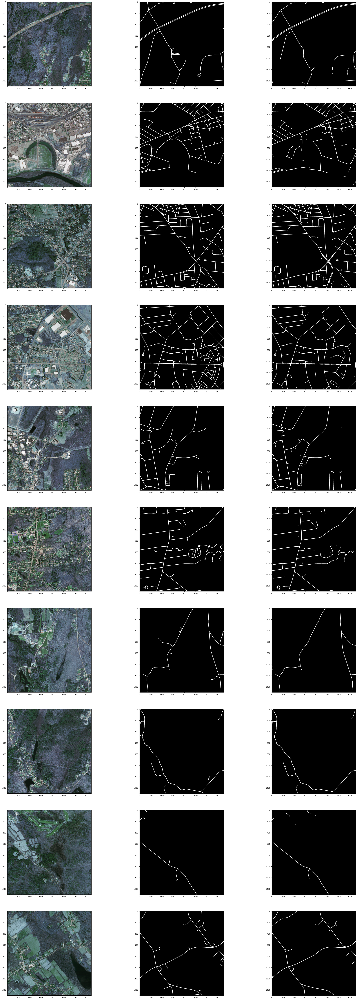

In [24]:
fig = plt.figure(figsize=(36, 96))
columns = 3
rows = 10
for i in range(10):
    fig.add_subplot(rows, columns, i*3+1)
    plt.imshow(data_images[i])
    fig.add_subplot(rows, columns, i*3+2)
    plt.imshow(np.repeat(target_images[i], 3, axis=-1))
    fig.add_subplot(rows, columns, i*3+3)
    plt.imshow(np.repeat(pred_images[i], 3, axis=-1))

1/1 [==============================] - 11s 11s/step


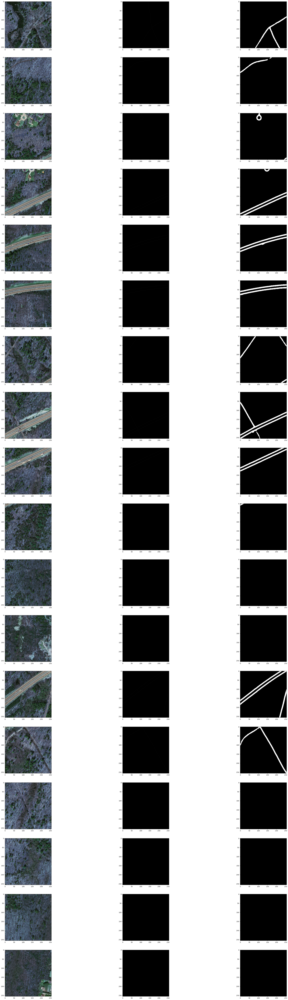

In [25]:
ori = test_images[:18]
label = test_labels[:18]
pred = model.predict(ori)

fig = plt.figure(figsize=(40, 120))
columns = 3
rows = 18
for i in range(0, len(ori)):
    fig.add_subplot(rows, columns, i*3+1)
    plt.imshow(ori[i])
    fig.add_subplot(rows, columns, i*3+2)
    plt.imshow(np.repeat(label[i], 3, axis=-1))
    fig.add_subplot(rows, columns, i*3+3)
    plt.imshow(np.repeat(pred[i], 3, axis=-1))